# Project 2 Board game object tracking
* Krzysztof Weber 151934
* Adam Mielniczuk 151928

The game chosen by us is chess.
The aim of the first milestone was to detect two game pieces. We were able to detect a chessboard and all the pieces. There are still some difficulties with the object detection but we are still working on it.

All functions used in latter examples are defined in utils.py file. It is to make the report more readable.

In [2]:
from utils import *

## Data preparation.

We have prepared 9 recordings of 9 chess games. The are in three categories:
1. Easy - Static camera, good lighting, hand covering parts of the board
2. Medium - Static camera, shady lighting, hand covering parts of the board
3. Hard - Shaky camera movements, shady lighting, hand covering parts of the board

## Board detection

In [3]:
chess = video_from_path('recordings\Easy1.mp4')

Video loaded
912 720
30.00030000300003


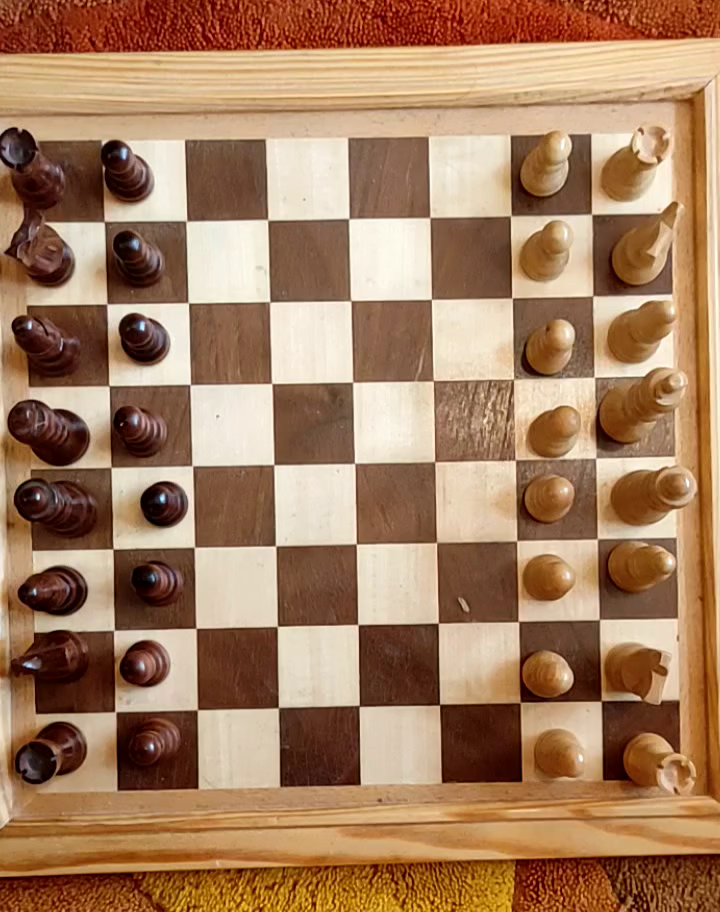

In [4]:
frame = get_first_frame(chess)

Finding lines is made using HoughLinesP function along with canny edge detection. The lines are then represented with slopes and shifts defined in the form of y = ax + b and x = ay + b due to the fact that many lines are perfectly or almost perfectly vertical or horizontal.

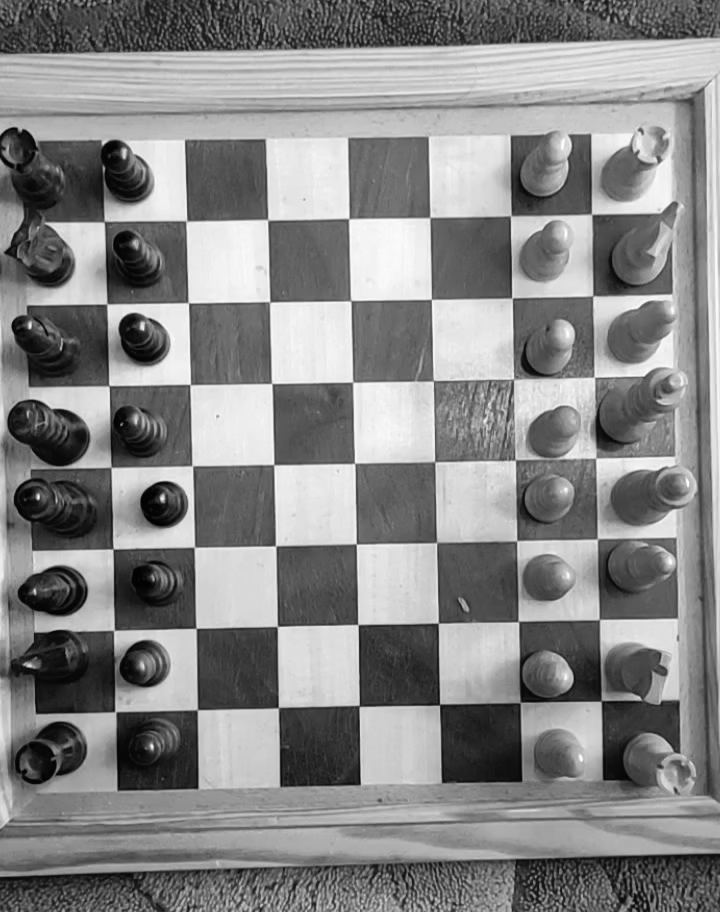

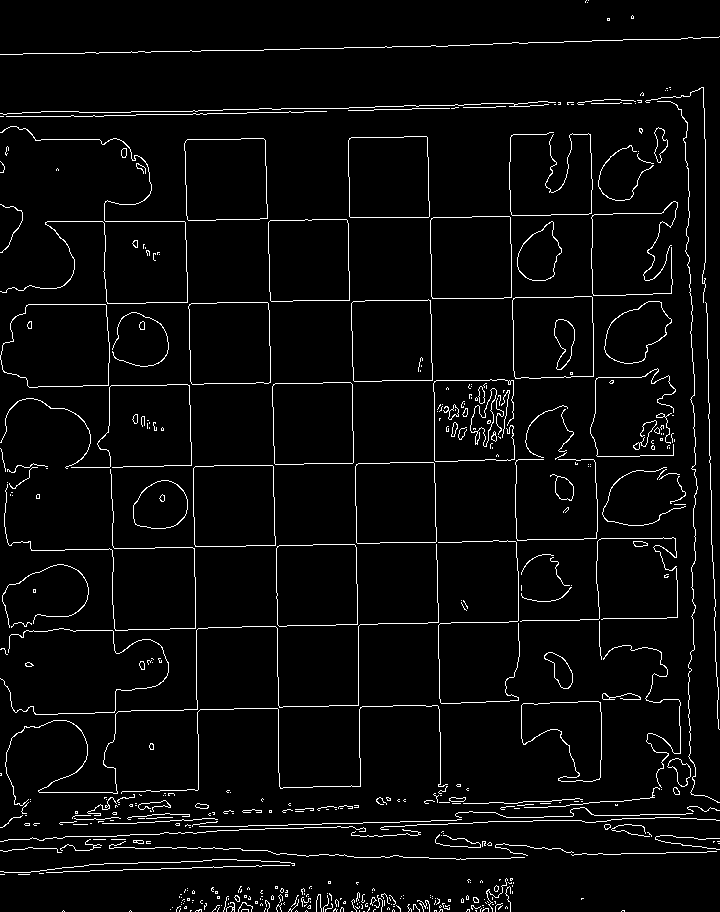

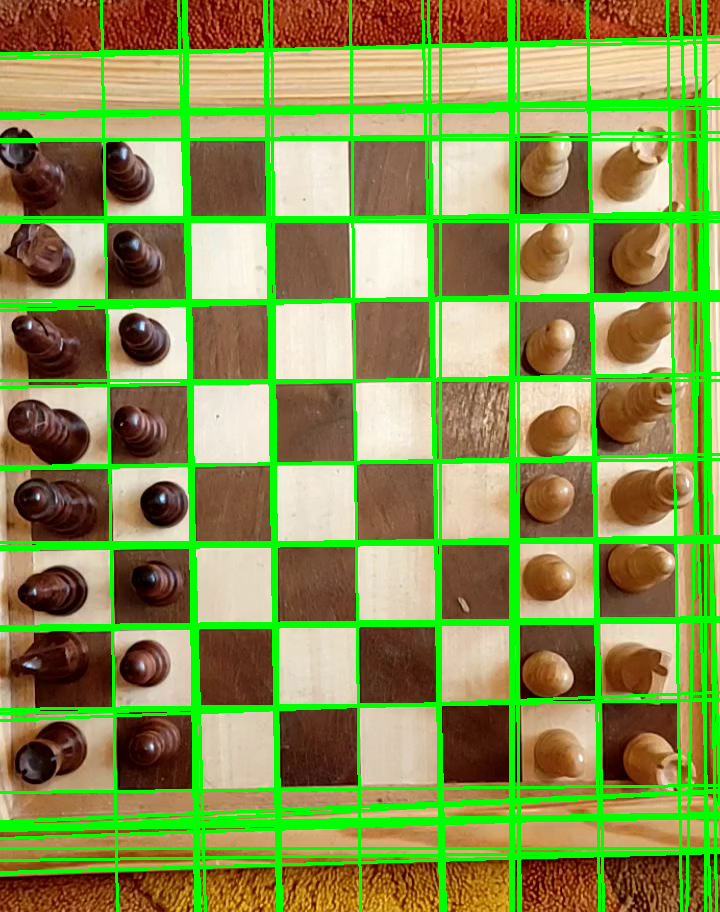

In [5]:
lines = find_lines(frame)

Here we are looking for the squares on the chessboard. It is done by using the findContours function from cv2 on the threshold image. The we then calculate the convex hull of the contour to get rid of any distortions. If the contour has 4 edges and the lengths of the opposite edges are similar, then the contour is considered a chessboard square. Information about the chessboard squares: their width, height and the slopes of the edges will be used in chessboard grid detection.

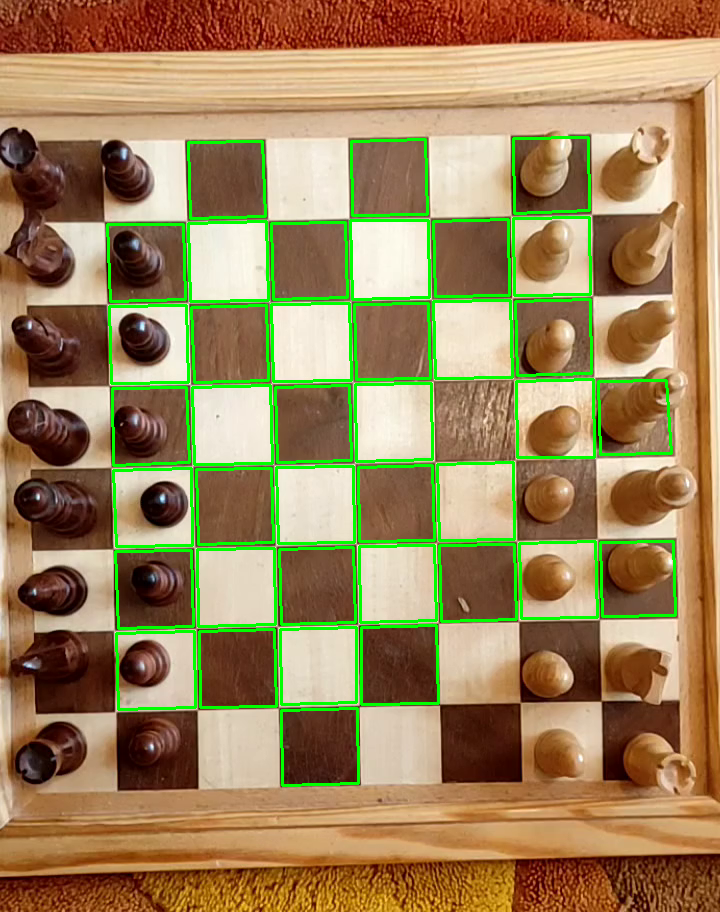

In [6]:
gap_lengths, new_lines = find_square_parameters(frame)
lines.extend(new_lines)

Based on the square parameters we try to find a subset of 18 lines representing a grid. Lines should be in the similar distances from each other as the length of the square edges and their slopes should be similar to square slopes.

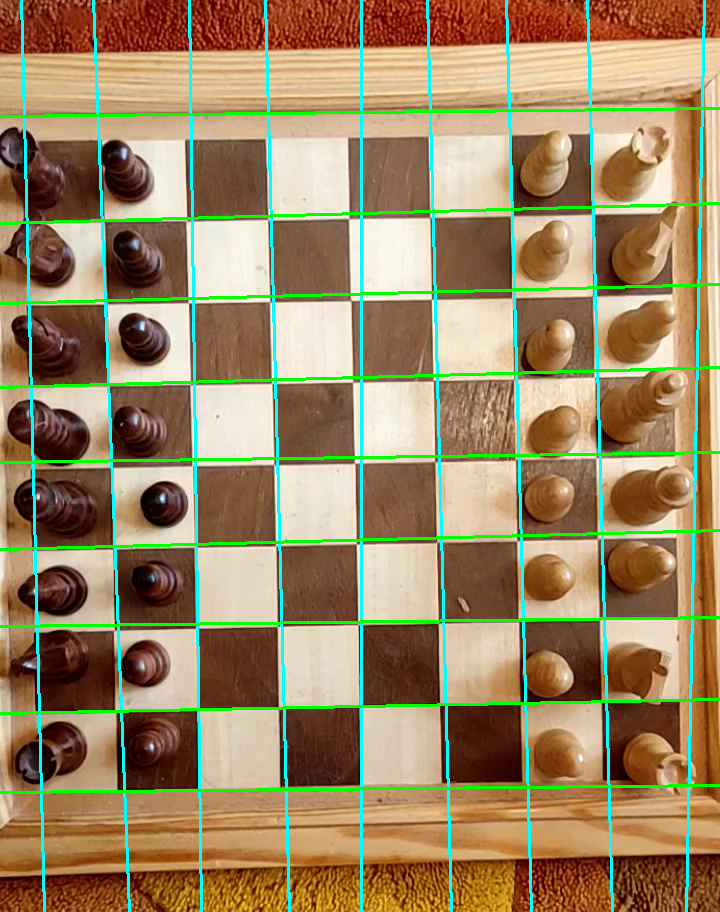

In [7]:
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.1)

Finally based on the chosen lines and their intersections we can define a chessboard grid with each cell being its own contour. 

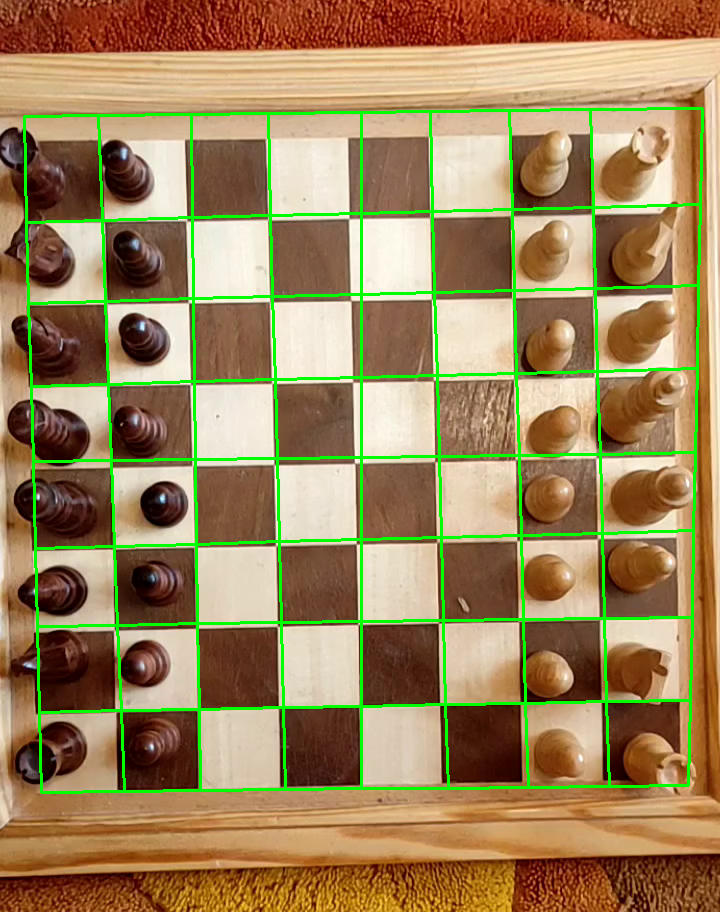

In [8]:
square_contours = find_square_contours(frame, chessboard_lines)

## Chessboard tracking an figure detection

As on the hard videos the image is shaky the position of the chessboard must be tracked. To achieve this we find a bounding box by identifying bottom-left and top-right corners of the chessboard grid. The chessboard is then tracked by the MIL tracker. The grid is adjusted appropriately to the tracked bounding box.

The figures are found using a cv2 function goodFeaturesToTrack not to include chessboard corners we filter out those points that are close to grid lines.

## Processing steps for each subset

### Easy

#### Easy1

Video loaded
912 720
30.00030000300003


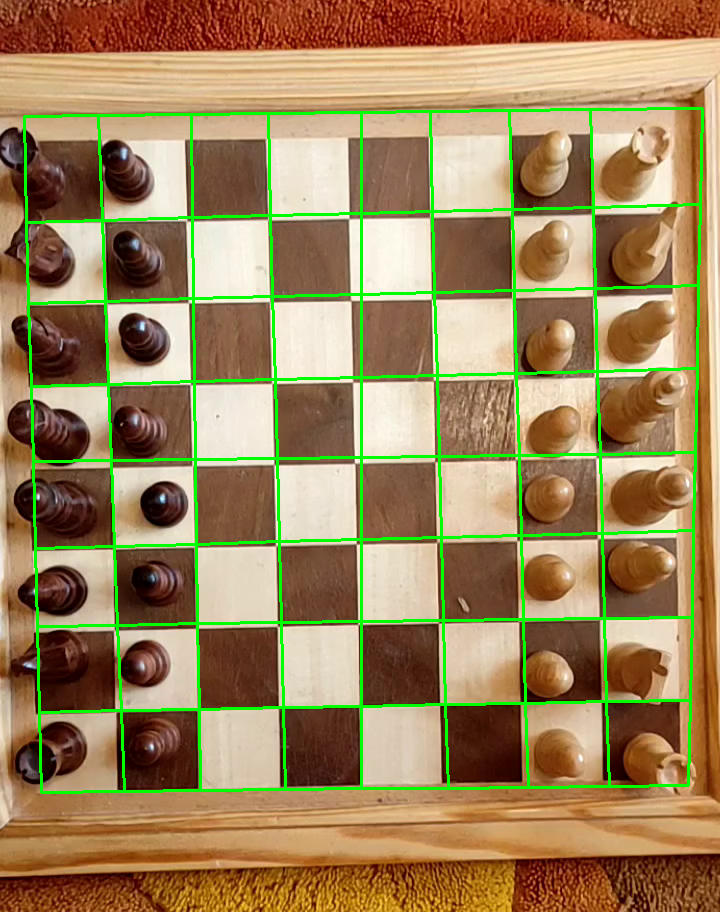

In [11]:
chess = video_from_path('recordings\Easy1.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.1, if_display=False)
square_contours = find_square_contours(frame, chessboard_lines)

In [4]:
write_and_detect_chessboard(chess, square_contours, 'Easy1')

#### Easy2

Video loaded
920 720
30.00030000300003


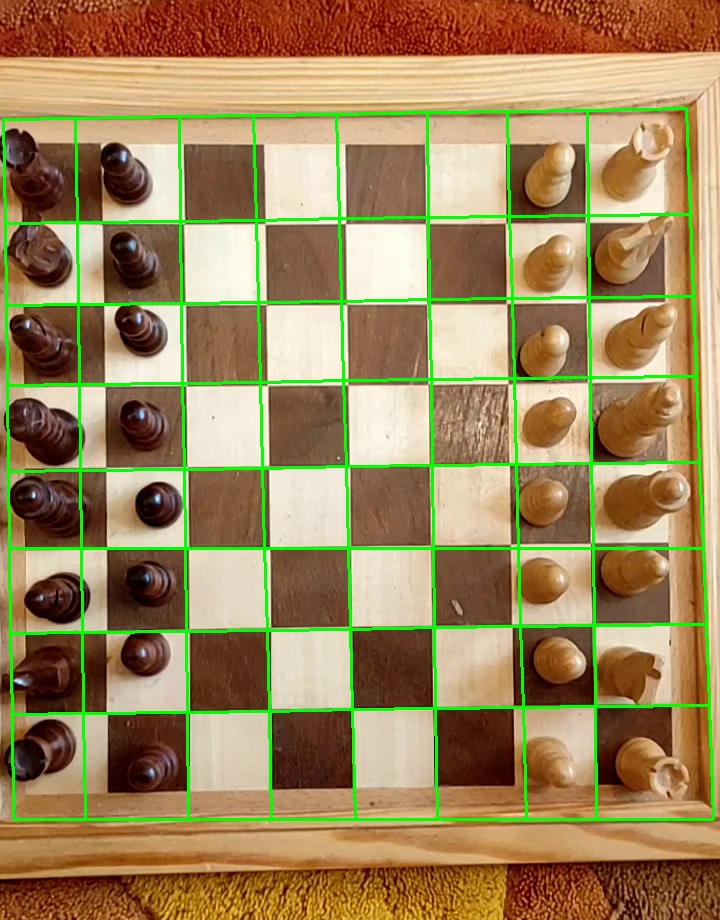

In [12]:
chess = video_from_path('recordings\Easy2.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.18, if_display=False)
square_contours = find_square_contours(frame, chessboard_lines)

In [6]:
write_and_detect_chessboard(chess, square_contours, 'Easy2')

#### Easy3

Video loaded
876 720
30.00030000300003


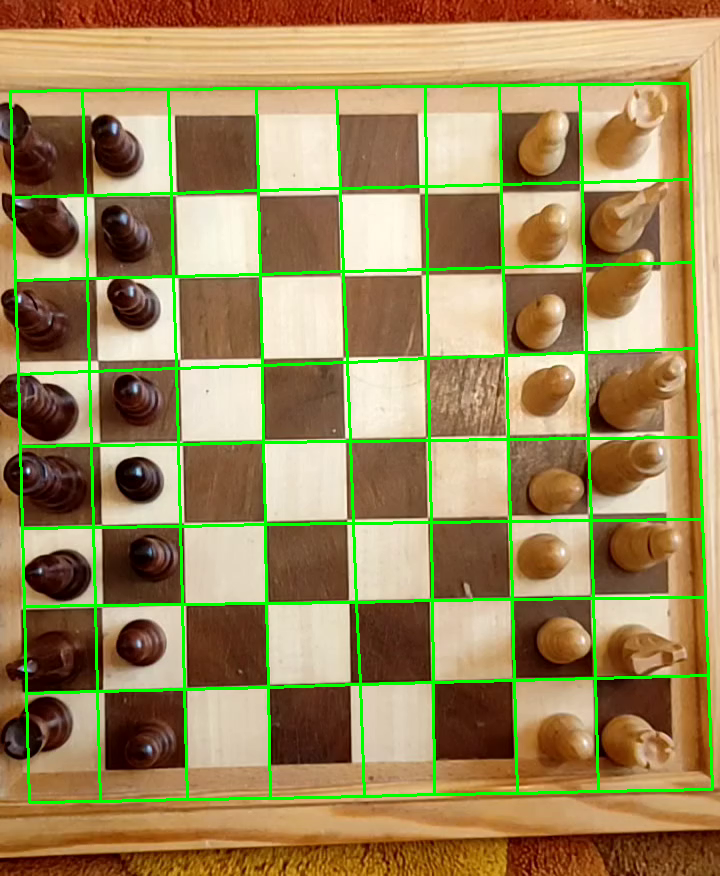

In [13]:
chess = video_from_path('recordings\Easy3.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.15, if_display=False)
chessboard_lines = [chessboard_lines[0], chessboard_lines[2]]
square_contours = find_square_contours(frame, chessboard_lines)

In [8]:
write_and_detect_chessboard(chess, square_contours, 'Easy3')

### Medium

#### Medium 1

Video loaded
866 720
30.00030000300003


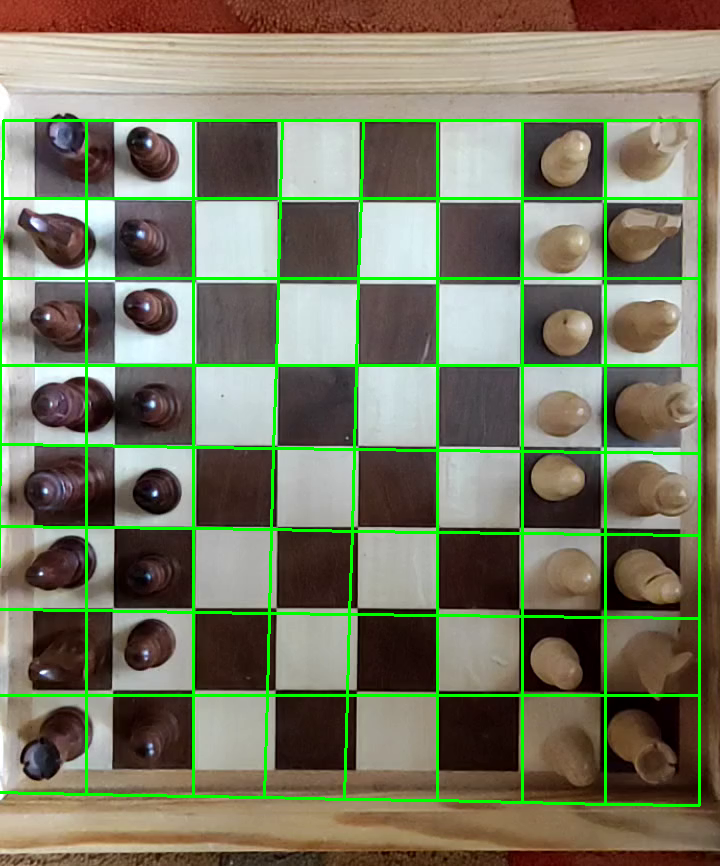

In [14]:
chess = video_from_path('recordings\Medium1.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.15, if_display=False)
square_contours = find_square_contours(frame, chessboard_lines)

In [10]:
write_and_detect_chessboard(chess, square_contours, 'Medium1')

#### Medium 2

Video loaded
884 720
30.00030000300003


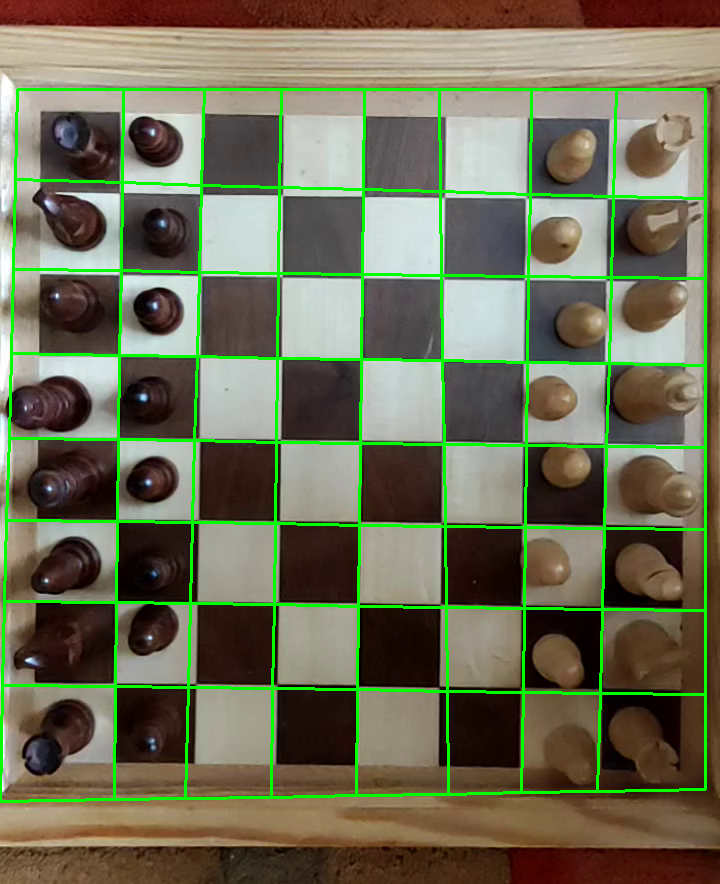

In [15]:
chess = video_from_path('recordings\Medium2.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.15, if_display=False)
square_contours = find_square_contours(frame, chessboard_lines)

In [12]:
write_and_detect_chessboard(chess, square_contours, 'Medium2')

#### Medium 3

Video loaded
876 720
30.00030000300003


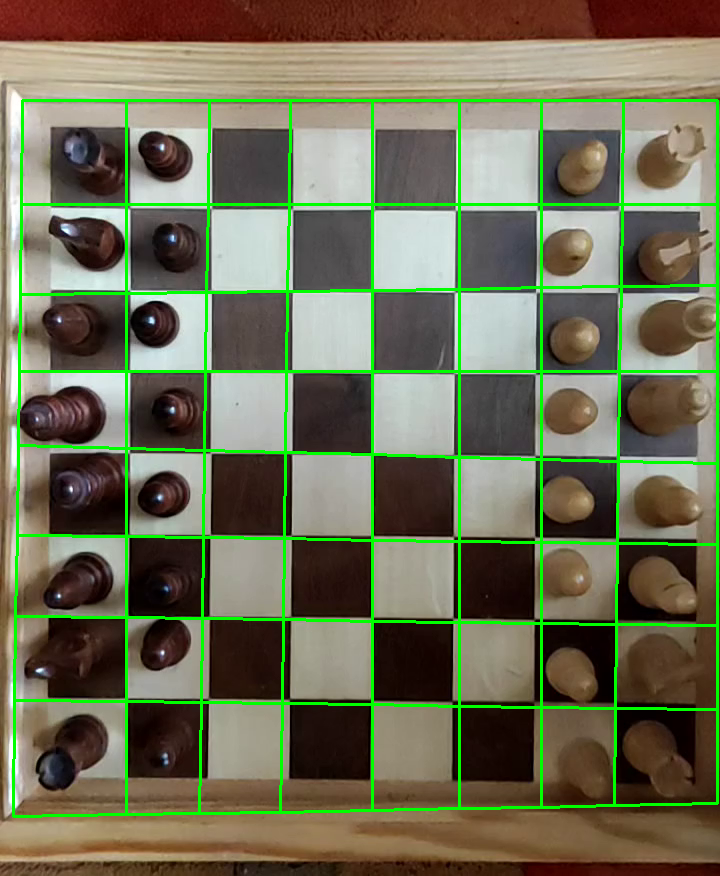

In [16]:
chess = video_from_path('recordings\Medium3.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.15, if_display=False)
square_contours = find_square_contours(frame, chessboard_lines)

In [14]:
write_and_detect_chessboard(chess, square_contours, 'Medium2')

### Hard

#### Hard1

Video loaded
816 720
30.00030000300003


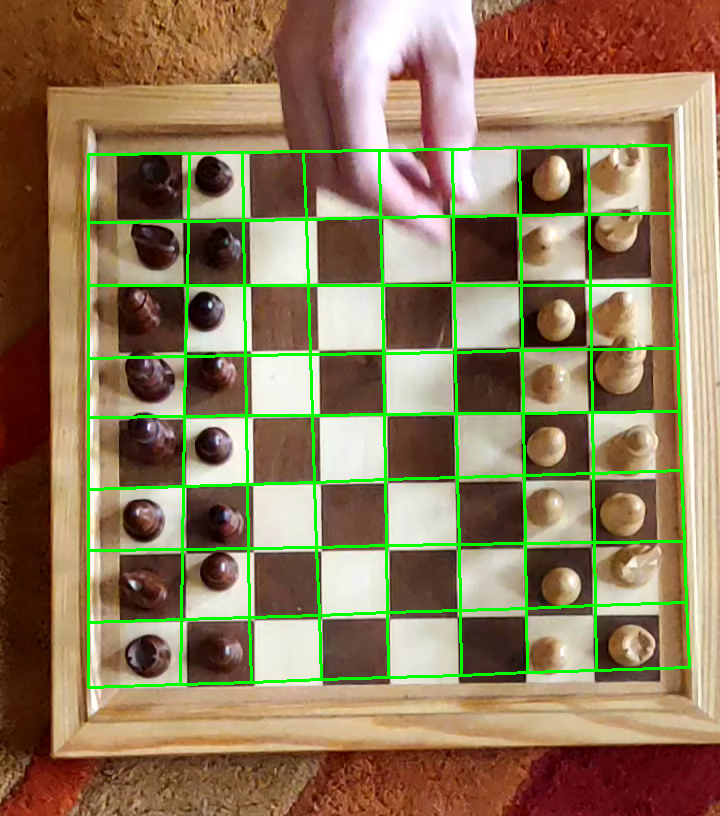

In [17]:
chess = video_from_path('recordings\Hard1.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
lines.extend(new_lines)
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.2)
chessboard_lines[1][0][0] = 418
square_contours = find_square_contours(frame, chessboard_lines)

In [16]:
write_and_detect_chessboard(chess, square_contours, 'Hard1')

#### Hard2

In [17]:
from utils import *

Video loaded
798 720
30.00030000300003


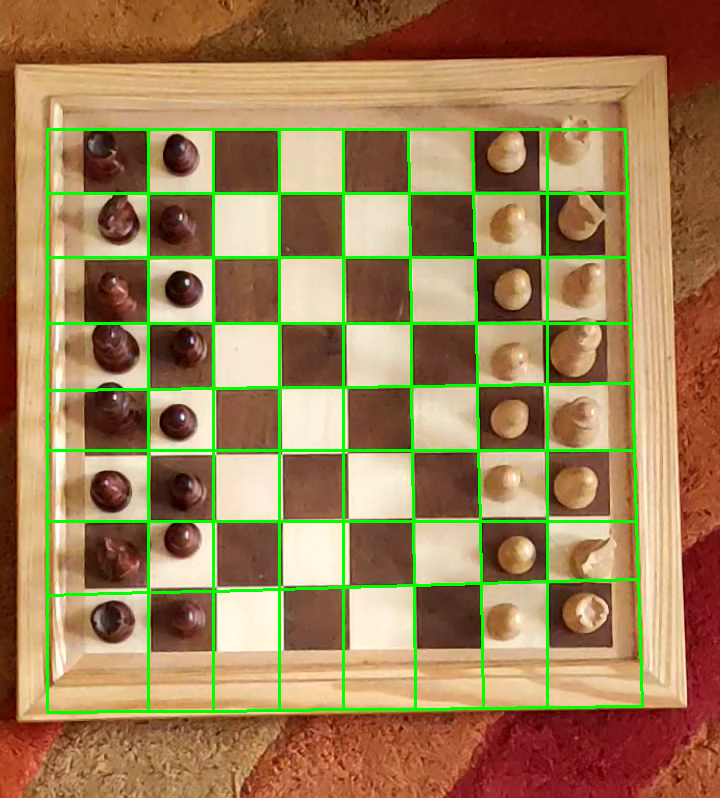

In [18]:
chess = video_from_path('recordings\Hard2.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
gap_lengths = {1.5538487969884918: 62.00403199585499, 3.1088175091857173: 61.51638903933426}
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.2, if_display=False)
chessboard_lines[1][0][1] = 450
square_contours = find_square_contours(frame, chessboard_lines)

In [19]:
write_and_detect_chessboard(chess, square_contours, 'Hard2')

#### Hard3

Video loaded
720 752
30.00030000300003


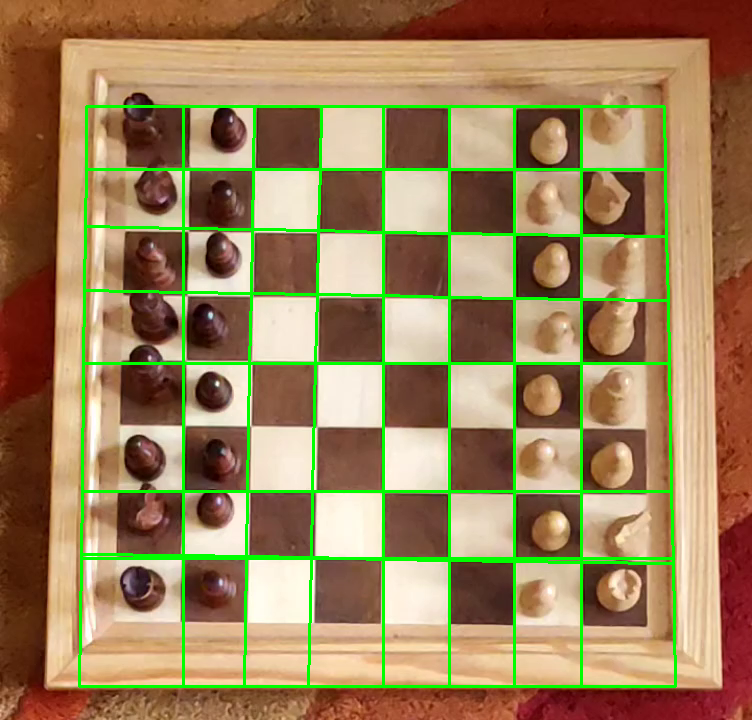

In [20]:
chess = video_from_path('recordings\Hard3.mp4')
frame = get_first_frame(chess, if_display=False)
lines = find_lines(frame, if_display=False)
gap_lengths, new_lines = find_square_parameters(frame, if_display=False)
print(lines)
gap_lengths = {1.5538487969884918: 62.00403199585499, 0: 61.51638903933426}
chessboard_lines = find_chessboard_lines(frame, lines, gap_lengths, aim_distance_correction=1.2, if_display=False)
square_contours = find_square_contours(frame, chessboard_lines)

In [21]:
write_and_detect_chessboard(chess, square_contours, 'Hard3')

## Exemplary frames

### Easy
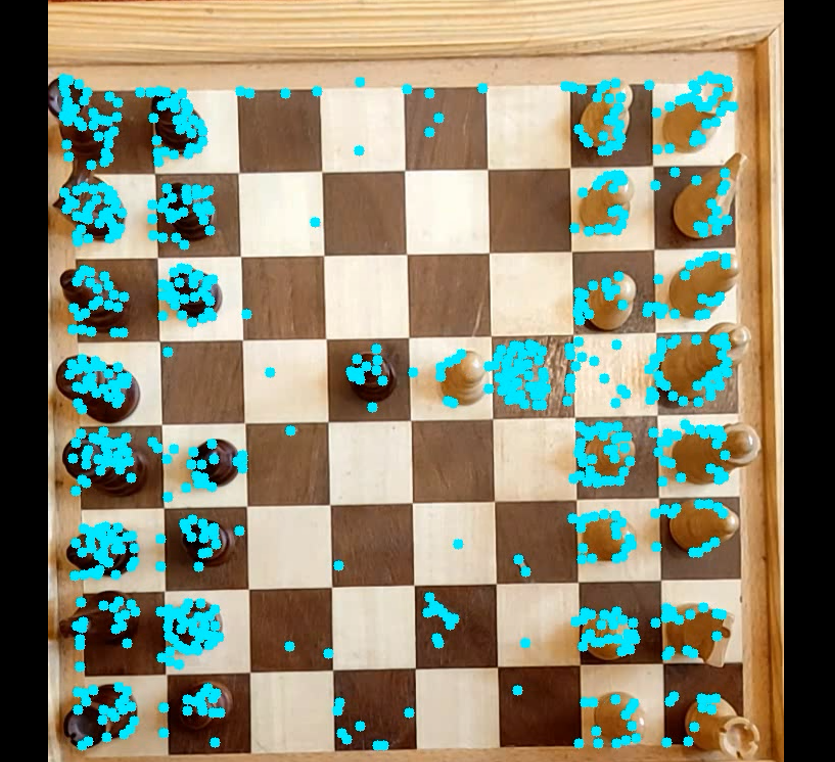
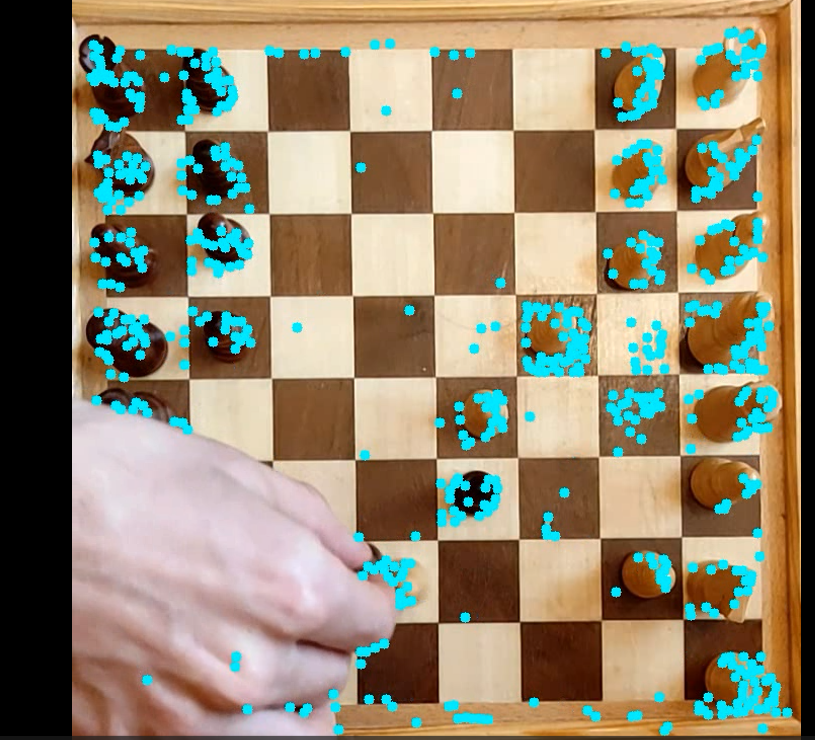
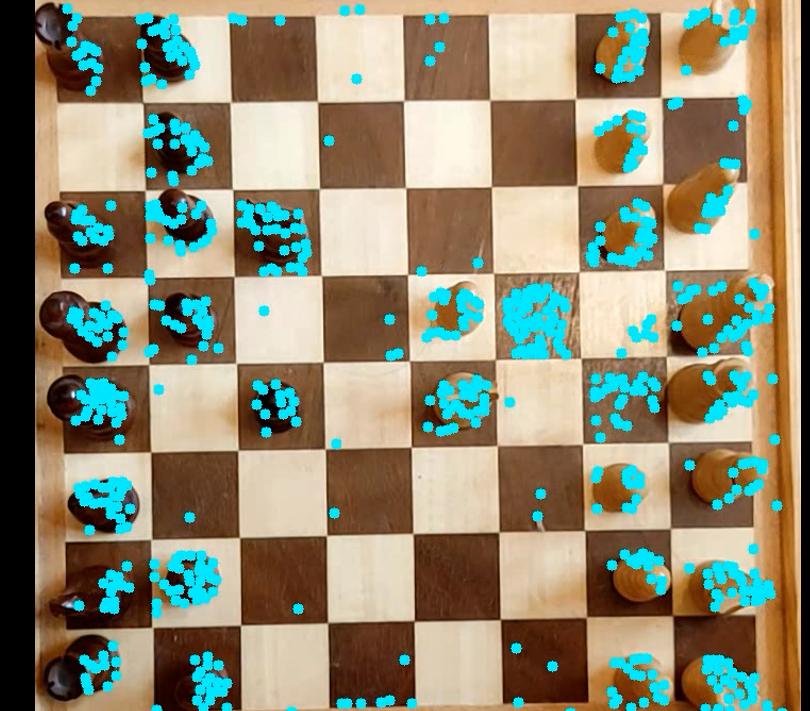

### Medium
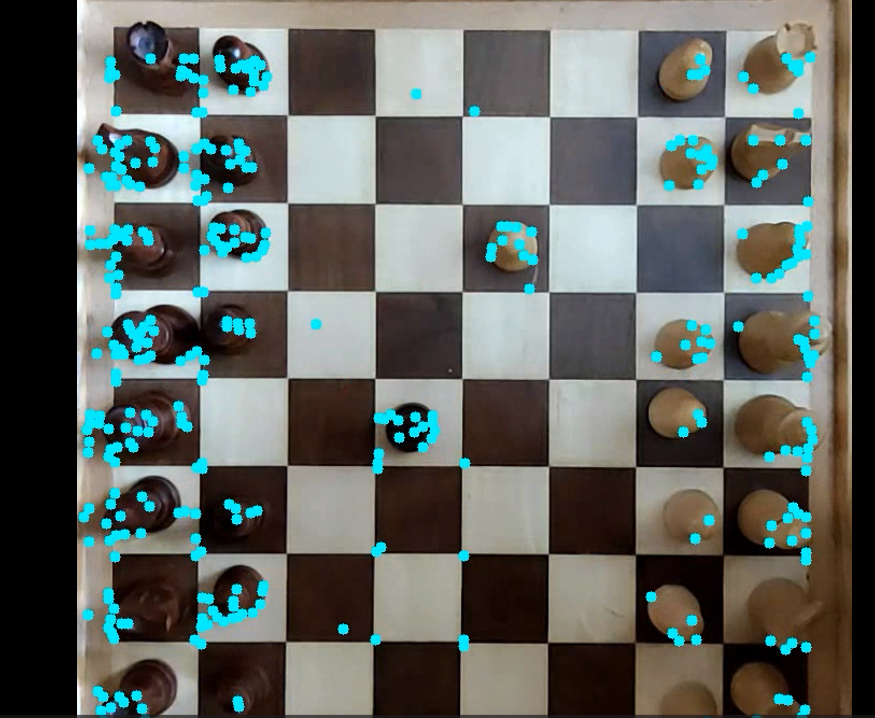
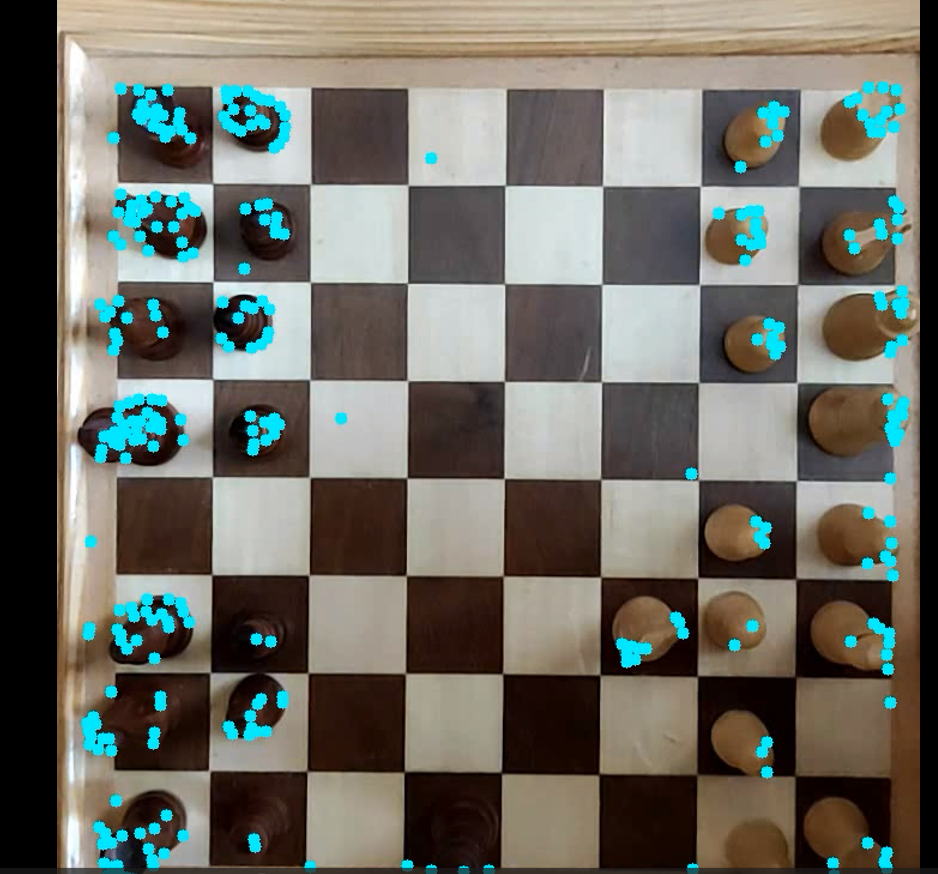

### Hard
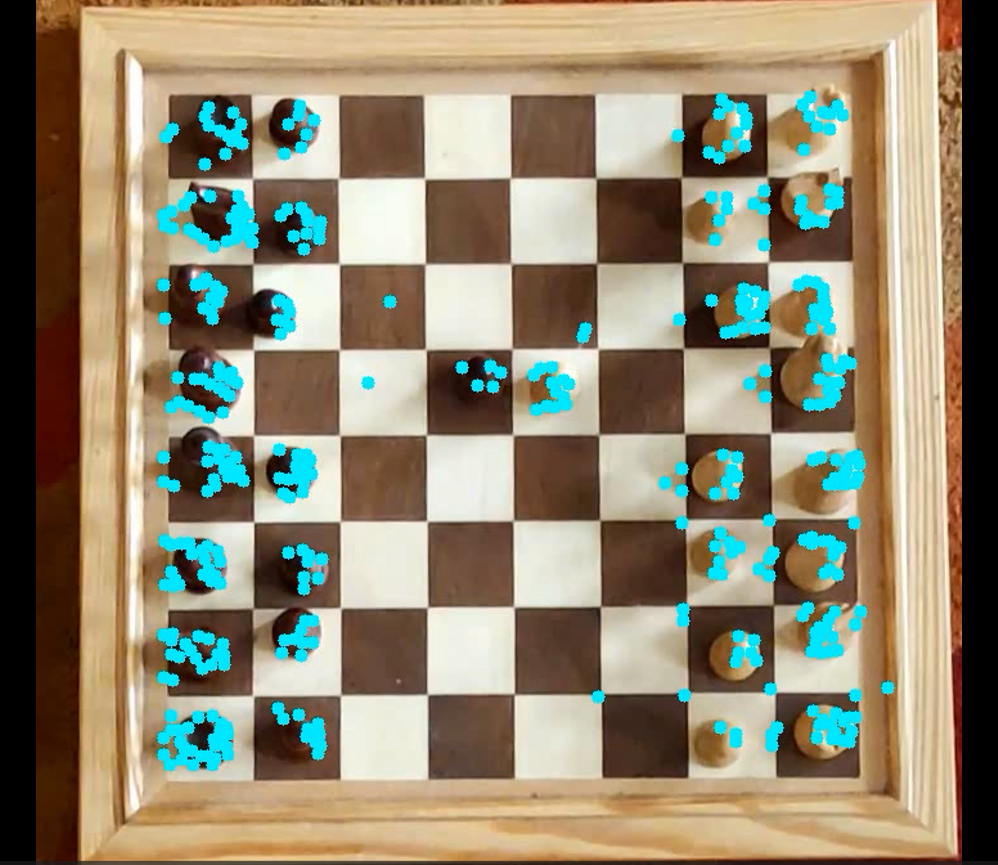
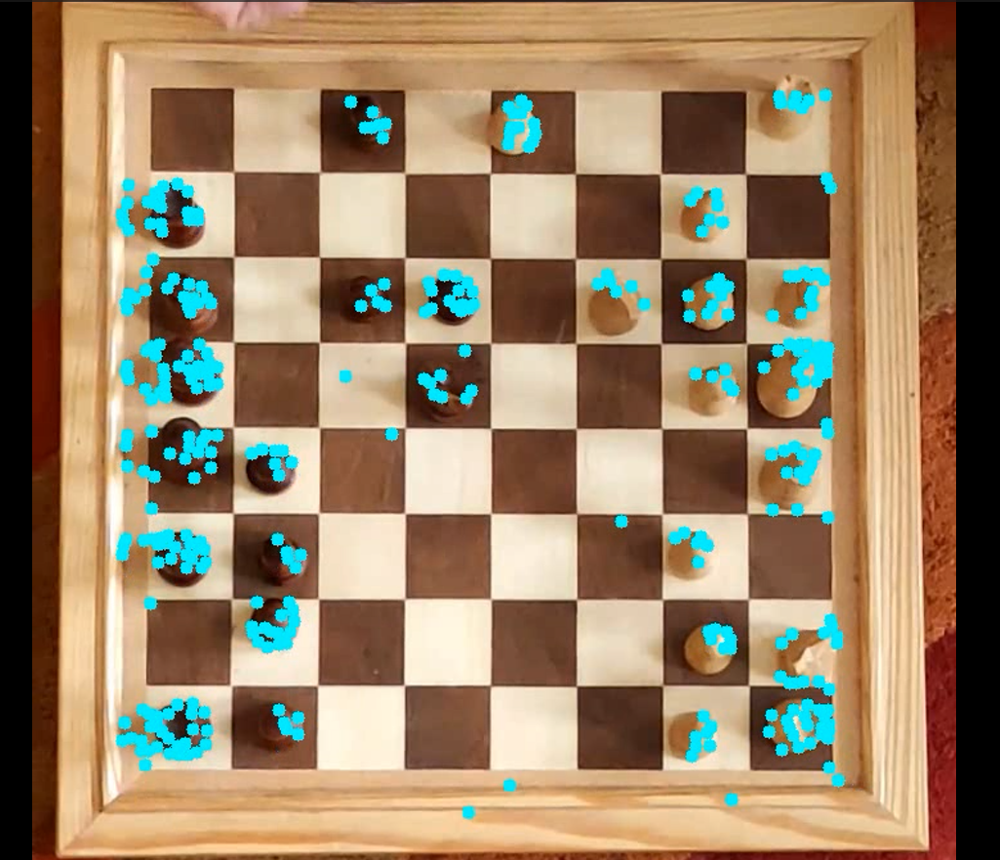
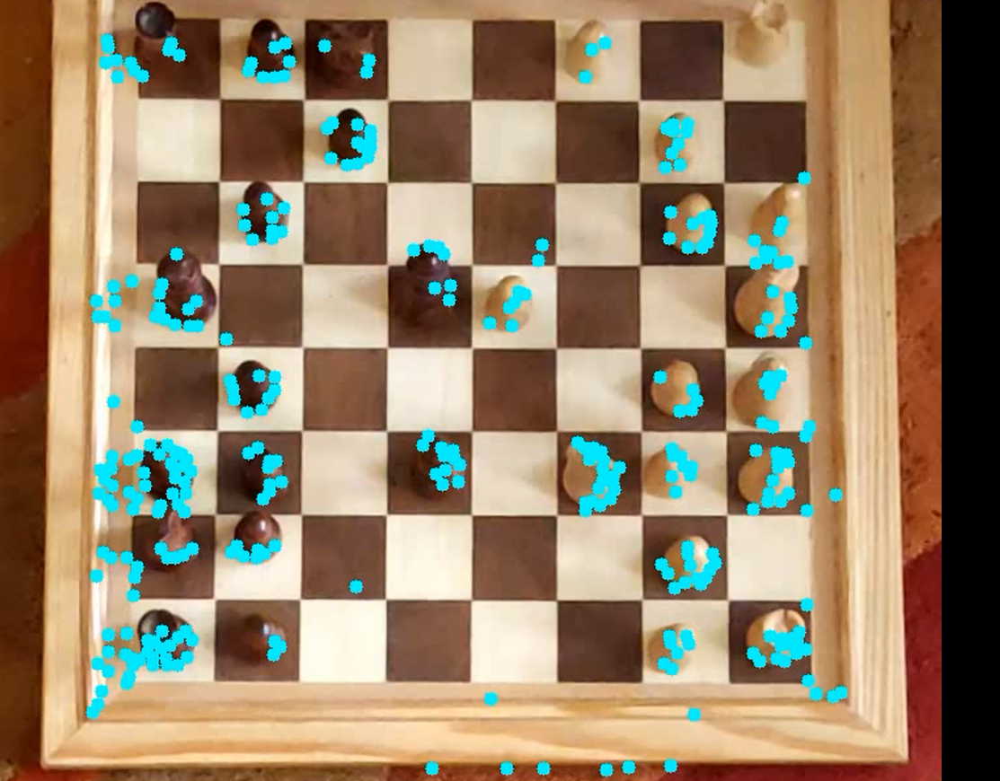
